In [1]:
import sys 
import numpy as np
import os

from dataserver import FileServer


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
SEQ_LEN      = 64
N_FEATURES   = 8
Z_DIM        = 32

names = [   
    "2020-11-12-09-36-01-591",
    "2020-11-10-08-54-03-947"
]
session_dirs = [ os.path.join("data/good", f) for f in names ]

dataserver = FileServer( session_dirs = session_dirs)

{'index': 0, 'suit': 4, 'session': '2020-11-12-09-36-01-591', 'samples': 404768}
{'index': 1, 'suit': 5, 'session': '2020-11-12-09-36-01-591', 'samples': 420336}
{'index': 2, 'suit': 1, 'session': '2020-11-12-09-36-01-591', 'samples': 266880}
{'index': 3, 'suit': 3, 'session': '2020-11-12-09-36-01-591', 'samples': 393648}
{'index': 4, 'suit': 6, 'session': '2020-11-12-09-36-01-591', 'samples': 363624}
{'index': 5, 'suit': 4, 'session': '2020-11-10-08-54-03-947', 'samples': 236856}
{'index': 6, 'suit': 1, 'session': '2020-11-10-08-54-03-947', 'samples': 282448}
{'index': 7, 'suit': 5, 'session': '2020-11-10-08-54-03-947', 'samples': 264656}
{'index': 8, 'suit': 3, 'session': '2020-11-10-08-54-03-947', 'samples': 296904}
{'index': 9, 'suit': 2, 'session': '2020-11-10-08-54-03-947', 'samples': 40032}
{'index': 10, 'suit': 6, 'session': '2020-11-10-08-54-03-947', 'samples': 295792}
Loaded: 11 Sessions


In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')

In [5]:
colors = [
    [   "#47b1b9",
        "#499dbb",
        "#4a8abd",
        "#4c76be",
        "#4e62c0",
        "#504fc1",
        "#6751c3",
        "#7e52c5",],

    [   "#453283",
        "#563286",
        "#673289",
        "#7a328c",
        "#8e338f",
        "#913381",
        "#943371",
        "#973360",],

    [   "#34192d",
        "#401d38",
        "#4d2042",
        "#246065",
        "#254f68",
        "#253e6a",
        "#262b6d",
        "#352670",]
    ]

ch_names = [
    "R Shoulder",
    "R Knee",
    "R Foot",
    "R Elbow",
    "L Elbow",
    "L Foot",
    "L Knee",
    "L Shoulder"
]



In [6]:
WINDOW = 100
TIME_CONVERSION = 20e-3 / 60
SCALE = 2.0

SEQUENCE = 60000
sequences = dataserver.get_batch(sequence_length = SEQUENCE)


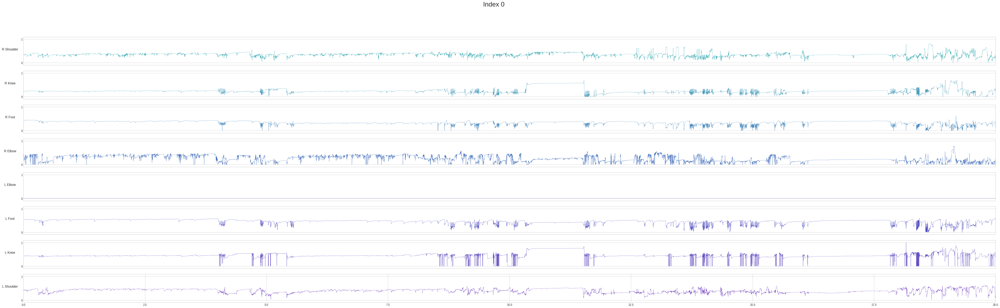

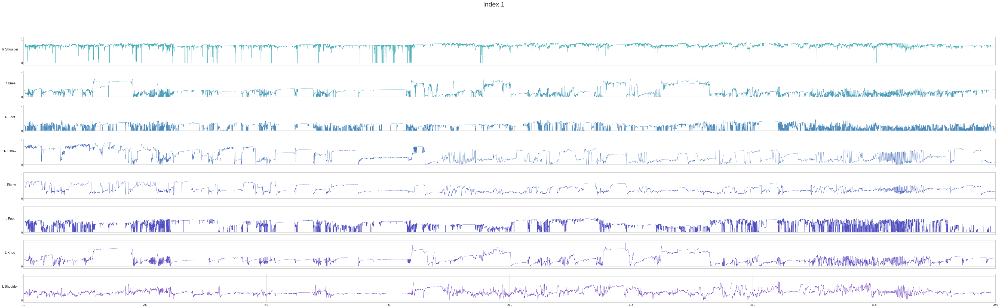

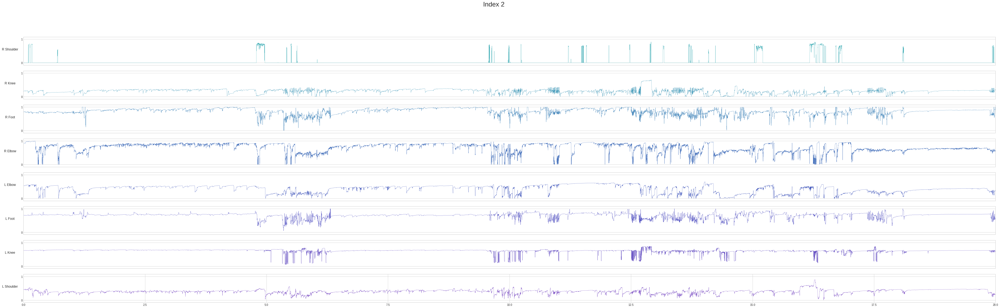

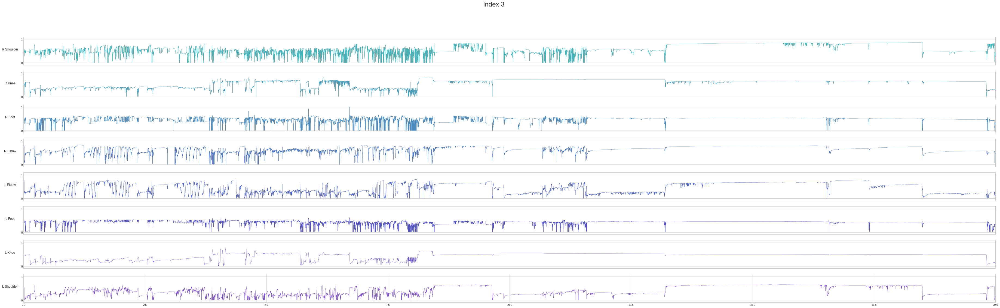

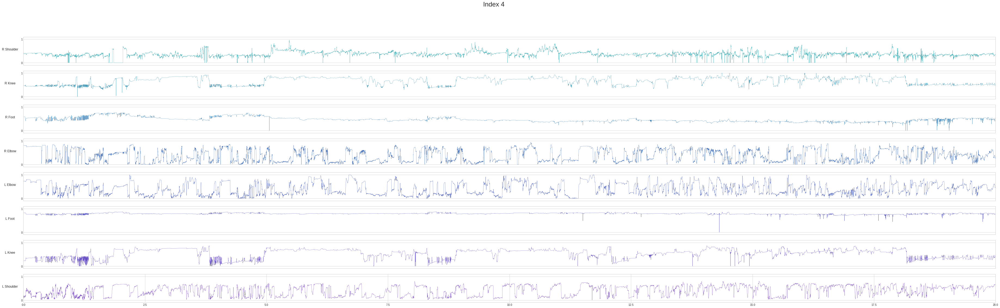

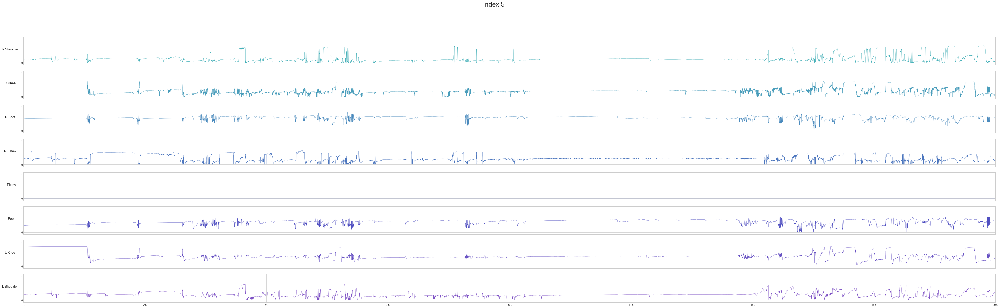

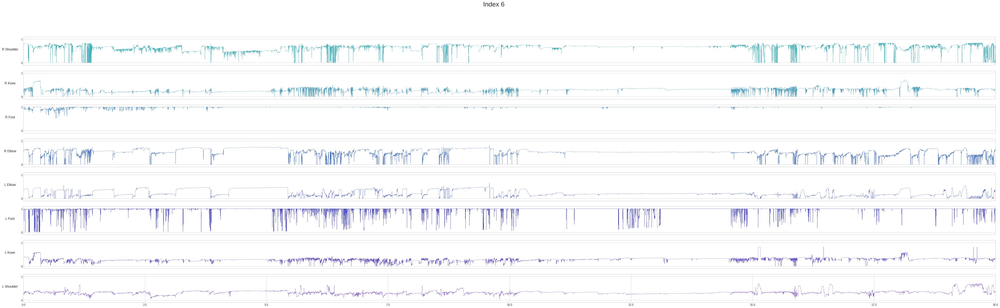

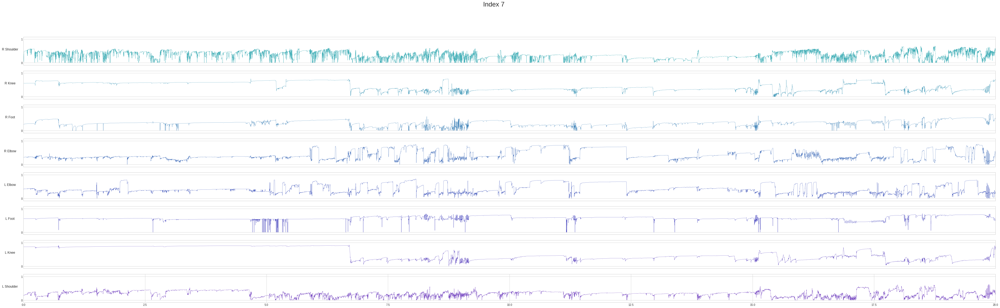

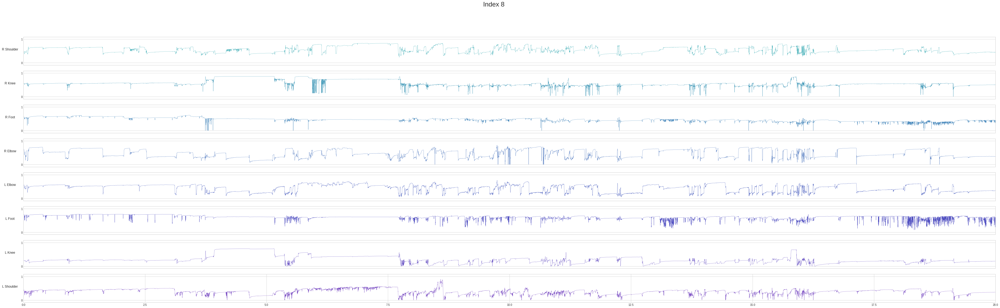

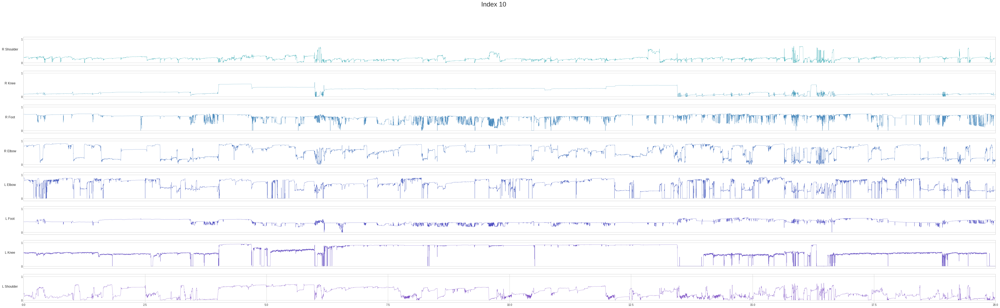

In [7]:
def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / float(N)

for index, sequence in sequences.items():

    fig, axs = plt.subplots(8, 1, figsize=(32 * SCALE, 9 * SCALE))
    fig.suptitle(f"Index {index}", fontsize=24)

    for ch in range(8):
        data = sequence[:,ch]

        #ravr = running_mean(data, WINDOW)

        axs[ch].set_ylim(-0.1, 1.1) 
        axs[ch].set_yticks([0.0, 1.0])


        axs[ch].set_xlim(0.0, SEQUENCE * TIME_CONVERSION) 
        if(ch != 7):
            axs[ch].get_xaxis().set_visible(False)

        axs[ch].set_ylabel(ch_names[ch], rotation=0, labelpad=40, fontsize='large') 

       

        #axs[ch].plot((np.arange(ravr.size) + SEQUENCE)  * TIME_CONVERSION , ravr, color="#15474f", linewidth=0.5, linestyle='dashed' )
        axs[ch].plot((np.arange(data.size) * TIME_CONVERSION), data        , color=colors[0][ch], linewidth=0.5 )

    plt.savefig(f'figures/figure_{index}.svg')
    plt.savefig(f'figures/figure_{index}.png')
